In [1]:
import pandas as pd
from pycaret.time_series import *


In [115]:
data = pd.read_csv("data/petr_brent.csv")
data = data[["DATE", "VALUE (US$)"]]
data["DATE"] = pd.DatetimeIndex(data["DATE"])

data.head(5)


,DATE,VALUE (US$)
0,2002-01-01,NaN
1,2002-01-02,20.13
2,2002-01-03,20.47
3,2002-01-04,21.20
4,2002-01-05,NaN


In [116]:
data.tail()


,DATE,VALUE (US$)
7595,2024-05-07,82.69
7596,2024-05-08,82.44
7597,2024-05-09,83.27
7598,2024-05-10,83.39
7599,2024-05-13,83.18


In [117]:
data.set_index("DATE", inplace=True)
full_date_range = pd.date_range(start="2002-01-01", end="2024-05-13", freq="D")
data = data.reindex(full_date_range)
data["VALUE (US$)"] = data["VALUE (US$)"].interpolate(method="linear").bfill()


In [118]:
data.info()


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8169 entries, 2002-01-01 to 2024-05-13
Freq: D
Data columns (total 1 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   VALUE (US$)  8169 non-null   float64
dtypes: float64(1)
memory usage: 127.6 KB


<Axes: >

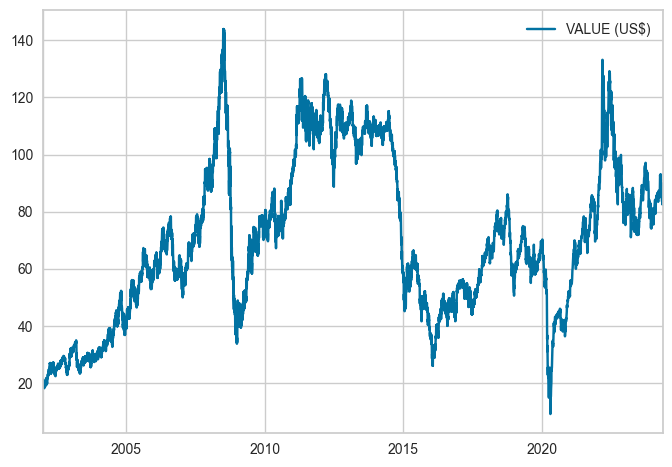

In [119]:
data.plot()


In [144]:
s = setup(data, fh=365, fold=6, session_id=123)


,Description,Value
0,session_id,123
1,Target,VALUE (US$)
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(8169, 1)"
5,Transformed data shape,"(8169, 1)"
6,Transformed train set shape,"(7804, 1)"
7,Transformed test set shape,"(365, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [145]:
check_stats()


,Test,Test Name,Data,Property,Setting,Value
0,Summary,Statistics,Transformed,Length,,8169.0
1,Summary,Statistics,Transformed,# Missing Values,,0.0
2,Summary,Statistics,Transformed,Mean,,69.972913
3,Summary,Statistics,Transformed,Median,,67.66
4,Summary,Statistics,Transformed,Standard Deviation,,27.758304
5,Summary,Statistics,Transformed,Variance,,770.523438
6,Summary,Statistics,Transformed,Kurtosis,,-0.843298
7,Summary,Statistics,Transformed,Skewness,,0.214806
8,Summary,Statistics,Transformed,# Distinct Values,,4785.0
9,White Noise,Ljung-Box,Transformed,Test Statictic,"{'alpha': 0.05, 'K': 24}",190176.490043


In [146]:
plot_model(data_kwargs={"plot_data_type": ["original", "imputed", "transformed"]})


In [147]:
plot_model(plot="acf")


In [148]:
plot_model(plot="pacf")


In [149]:
plot_model(plot="diagnostics", fig_kwargs={"height": 800, "width": 1000})


In [150]:
plot_model(
    plot="diff",
    data_kwargs={
        "lags_list": [[1], [1, 30]],
        "acf": True,
        "pacf": True,
        "periodogram": True,
    },
    fig_kwargs={"height": 800, "width": 1500},
)


In [151]:
plot_model(
    plot="decomp", fig_kwargs={"height": 500}, data_kwargs={"seasonal_period": 4}
)


In [152]:
plot_model(plot="decomp_stl", fig_kwargs={"height": 500})


In [153]:
plot_model(plot="train_test_split", fig_kwargs={"height": 400, "width": 900})


In [154]:
plot_model(plot="cv", fig_kwargs={"height": 400, "width": 900})


In [122]:
from pycaret.time_series import TSForecastingExperiment

s = TSForecastingExperiment()


In [123]:
best = compare_models()


,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
omp_cds_dt,Orthogonal Matching Pursuit w/ Cond. Deseasonalize & Detrending,6.6364,4.8985,10.0935,11.8097,0.1162,0.1214,-1.1551,0.2583
lasso_cds_dt,Lasso w/ Cond. Deseasonalize & Detrending,6.7315,4.9575,10.2363,11.9507,0.1184,0.1237,-1.2412,0.2383
llar_cds_dt,Lasso Least Angular Regressor w/ Cond. Deseasonalize & Detrending,6.7751,4.9878,10.3028,12.0243,0.1193,0.1246,-1.2708,0.2550
en_cds_dt,Elastic Net w/ Cond. Deseasonalize & Detrending,7.0049,5.1490,10.6543,12.4173,0.1238,0.1294,-1.4368,0.2483
huber_cds_dt,Huber w/ Cond. Deseasonalize & Detrending,7.2520,5.2984,11.0657,12.8308,0.1293,0.1312,-1.9185,0.2483
br_cds_dt,Bayesian Ridge w/ Cond. Deseasonalize & Detrending,7.3192,5.3731,11.1339,12.9623,0.1301,0.1360,-1.6730,0.2317
ridge_cds_dt,Ridge w/ Cond. Deseasonalize & Detrending,7.3193,5.3731,11.1340,12.9626,0.1301,0.1360,-1.6730,0.2367
lr_cds_dt,Linear w/ Cond. Deseasonalize & Detrending,7.3193,5.3732,11.1341,12.9626,0.1301,0.1360,-1.6731,0.2683
rf_cds_dt,Random Forest w/ Cond. Deseasonalize & Detrending,7.4122,5.4161,11.2351,13.0237,0.1332,0.1397,-1.7913,0.9217
arima,ARIMA,7.6506,5.6326,11.6371,13.5941,0.1368,0.1430,-1.8768,0.0433


In [127]:
plot_model(best["ets"], plot="forecast")


KeyboardInterrupt: 

In [ ]:
plot_model(best, plot="diagnostics")


In [43]:
from pycaret.datasets import get_data

data = get_data("airline")


Period
1949-01    112.0
1949-02    118.0
1949-03    132.0
1949-04    129.0
1949-05    121.0
Freq: M, Name: Number of airline passengers, dtype: float64

In [45]:
data.info()


<class 'pandas.core.series.Series'>
PeriodIndex: 144 entries, 1949-01 to 1960-12
Freq: M
Series name: Number of airline passengers
Non-Null Count  Dtype  
--------------  -----  
144 non-null    float64
dtypes: float64(1)
memory usage: 2.2 KB
